<a href="https://colab.research.google.com/github/lauraredmondson/nma-eggplant-cobra/blob/master/RSA_Matteo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
fname = "kay_labels.npy"
if not os.path.exists(fname):
  !wget -qO $fname https://osf.io/r638s/download
fname = "kay_images.npz"
if not os.path.exists(fname):
  !wget -qO $fname https://osf.io/ymnjv/download

In [ ]:
with np.load(fname) as dobj:
    dat = dict(**dobj)
labels = np.load('kay_labels.npy')


`labels` is a 4 by stim array of class names:  
- row 3 has the labels predicted by a deep neural network (DNN) trained on Imagenet
- rows 0-2 correspond to different levels of the wordnet hierarchy for the DNN predictions

In [ ]:
print(labels[:,:4])

[['artifact' 'entity' 'animal' 'animal']
 ['instrumentality' 'round shape' 'vertebrate' 'vertebrate']
 ['equipment' 'sphere' 'mammal' 'amphibian']
 ['croquet ball' 'bubble' 'komondor' 'tailed frog']]


In [ ]:
import urllib
from scipy.io import loadmat
temp_test, _ = urllib.request.urlretrieve('https://github.com/lauraredmondson/nma-eggplant-cobra/raw/master/Data/y_test.mat')
temp_train,  _ = urllib.request.urlretrieve('https://github.com/lauraredmondson/nma-eggplant-cobra/raw/master/Data/y_train.mat')
y_test_ours = loadmat(temp_test)
y_train_ours = loadmat(temp_train)

In [ ]:
print(dat.keys())

dict_keys(['stimuli', 'stimuli_test', 'responses', 'responses_test', 'roi', 'roi_names'])


`dat` has the following fields:  
- `stimuli`: stim x i x j array of grayscale stimulus images
- `stimuli_test`: stim x i x j array of grayscale stimulus images in the test set  
- `responses`: stim x voxel array of z-scored BOLD response amplitude
- `responses_test`:  stim x voxel array of z-scored BOLD response amplitude in the test set  
- `roi`: array of voxel labels
- `roi_names`: array of names corresponding to voxel labels

In [ ]:
print(dat["stimuli"].shape)

(1750, 128, 128)


In [ ]:
print(dat["roi"].shape)
print(np.min(dat["roi"]))

(8428,)
1


In [ ]:
print(dat["responses"].shape)

(1750, 8428)


This is the number of voxels in each ROI. Note that `"Other"` voxels have been removed from this version of the dataset:

In [ ]:
dict(zip(dat["roi_names"], np.bincount(dat["roi"])))

{'LatOcc': 928,
 'Other': 0,
 'V1': 1294,
 'V2': 2083,
 'V3': 1790,
 'V3A': 484,
 'V3B': 314,
 'V4': 1535}

Each stimulus is a 128 x 128 grayscale array:

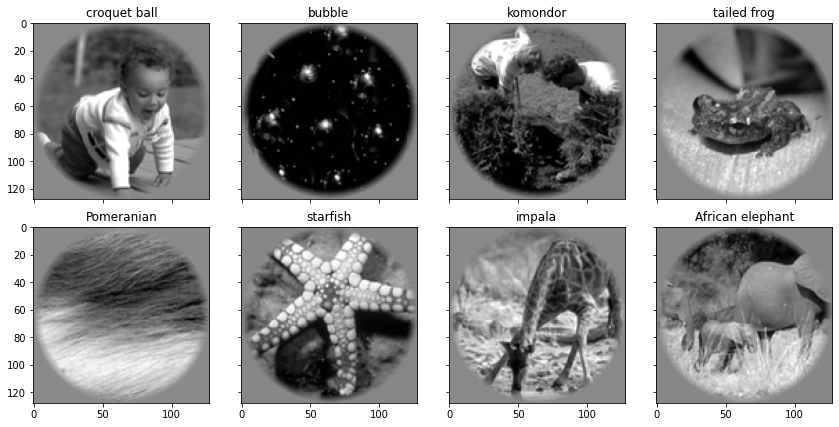

In [ ]:
f, axs = plt.subplots(2, 4, figsize=(12, 6), sharex=True, sharey=True)
for ax, im, lbl in zip(axs.flat, dat["stimuli"], labels[-1,:]):
  ax.imshow(im, cmap="gray")
  ax.set_title(lbl)
f.tight_layout()

Each stimulus is associated with a pattern of BOLD response across voxels in visual cortex:

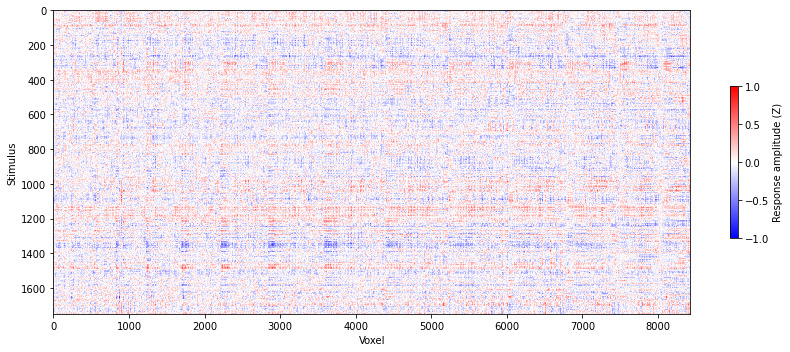

In [ ]:
f, ax = plt.subplots(figsize=(12, 5))
ax.set(xlabel="Voxel", ylabel="Stimulus")
heatmap = ax.imshow(dat["responses"], aspect="auto", vmin=-1, vmax=1, cmap="bwr")
f.colorbar(heatmap, shrink=.5, label="Response amplitude (Z)")
f.tight_layout()

The training/validation splits from the original paper are retained, so the 120 test stimuli and responses are in separate data structures:

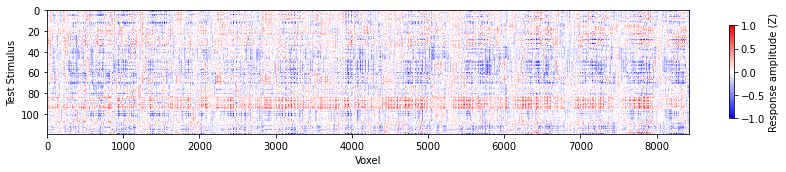

In [ ]:
f, ax = plt.subplots(figsize=(12, 2.5))
ax.set(xlabel="Voxel", ylabel="Test Stimulus")
heatmap = ax.imshow(dat["responses_test"], aspect="auto", vmin=-1, vmax=1, cmap="bwr")
f.colorbar(heatmap, shrink=.75, label="Response amplitude (Z)")
f.tight_layout()

In [ ]:
######### START THE COMPUTATION OF RSA #############

In [ ]:
# Import libraries

import warnings
import sys 
if not sys.warnoptions:
    warnings.simplefilter("ignore")

import os
import numpy as np
import pandas as pd
import scipy.io
from scipy import stats
from sklearn.manifold import MDS
import scipy.spatial.distance as sp_distance

import matplotlib.pyplot as plt
import seaborn as sns 
from mpl_toolkits.mplot3d import Axes3D

# %matplotlib notebook
%matplotlib inline
%autosave 5
sns.set(style = 'white', context='poster', rc={"lines.linewidth": 2.5})

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Autosaving every 5 seconds


(0.0, 90.0)

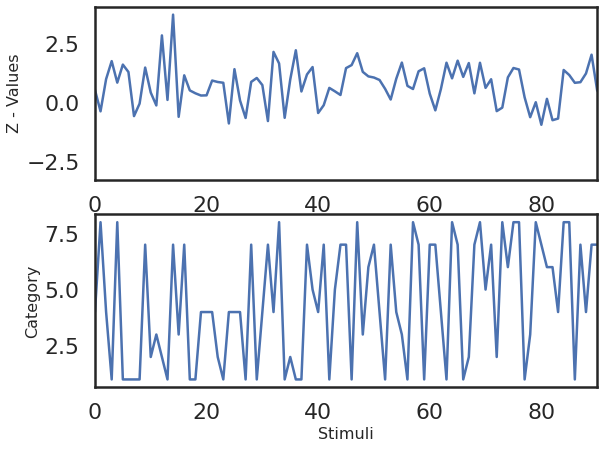

In [ ]:
plt.figure(figsize=(9, 7))

# Data plot
plt.subplot(2,1,1)
# Plot the activity per stimulus for a single voxel
plt.plot(dat["responses"][:, 0])  
plt.ylabel('Z - Values', fontsize=16)
plt.xlim(0, 90)

# Label plot
plt.subplot(2,1,2)
plt.plot(y_train_ours["y_train"])
plt.xlabel('Stimuli', fontsize=16)
plt.ylabel('Category', fontsize=16)
plt.xlim(0, 90)

(array([ 15.,  65., 241., 377., 467., 342., 168.,  60.,  11.,   4.]),
 array([-2.9557638 , -2.28668252, -1.61760123, -0.94851995, -0.27943867,
         0.38964261,  1.0587239 ,  1.72780518,  2.39688646,  3.06596775,
         3.73504903]),
 <a list of 10 Patch objects>)

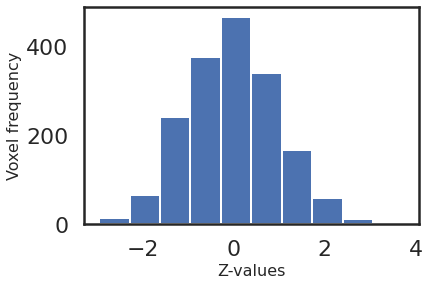

In [ ]:
# Display the distribution of t values for different voxels in this ROI.
plt.figure()
plt.ylabel('Voxel frequency', fontsize=16)
plt.xlabel('Z-values', fontsize=16)
plt.hist(dat["responses"][:, 0])

In [ ]:
# choose your ROI here! ######### 1=V1, 2=V2, 3=V3, 4=V3A, 5=V3B, 6=V4, 7=LatOcc
id = 4
roi_id = dat["roi"]== id
r = ['V1','V2','V3','V3A','V3B','V4','LatOcc']
print(np.min(dat["roi"]))

1


In [ ]:
dat["responses"][:, roi_id].shape

(1750, 484)

In [ ]:
print(y_train_ours["y_train"])

[[4]
 [8]
 [4]
 ...
 [2]
 [2]
 [6]]


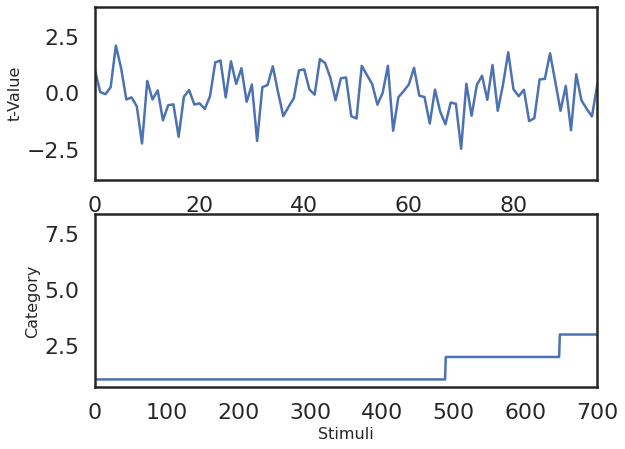

In [ ]:
#y = np.array(y_train_ours["y_train"])
sort_ids = np.argsort(y_train_ours["y_train"],axis=0)
dat_sorted = dat["responses"][sort_ids, roi_id]

plt.figure(figsize=(9,7))

# Plot the new sorted results
plt.subplot(2,1,1)
plt.plot(dat_sorted[:,0])
plt.ylabel('t-Value', fontsize=16)
plt.xlim(0, 96)

plt.subplot(2,1,2)
plt.plot(y_train_ours["y_train"][sort_ids,0])
plt.xlabel('Stimuli', fontsize=16)
plt.ylabel('Category', fontsize=16)
plt.xlim(0, 700)
plt.show()

(1750, 1294) (1750, 1750)
(1750, 2083) (1750, 1750)
(1750, 1790) (1750, 1750)
(1750, 484) (1750, 1750)
(1750, 314) (1750, 1750)
(1750, 1535) (1750, 1750)
(1750, 928) (1750, 1750)


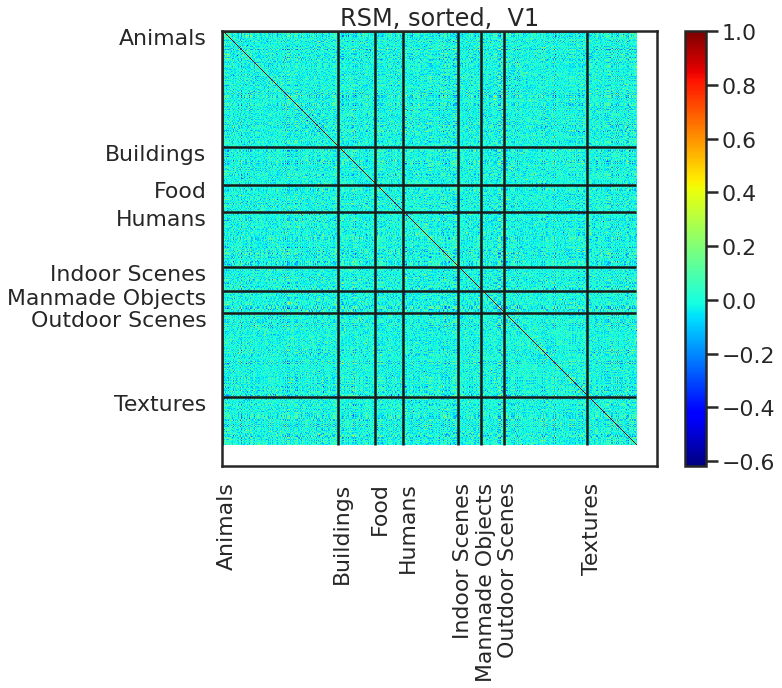

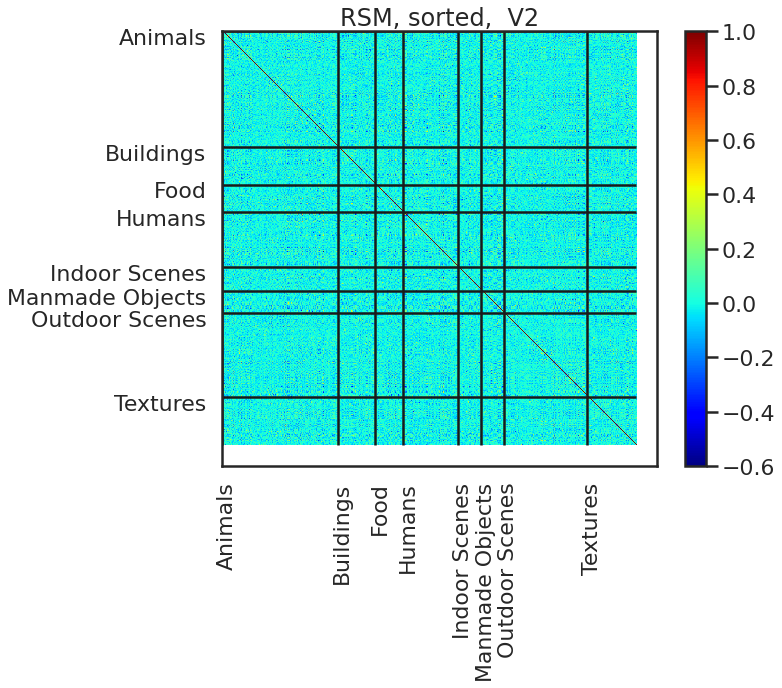

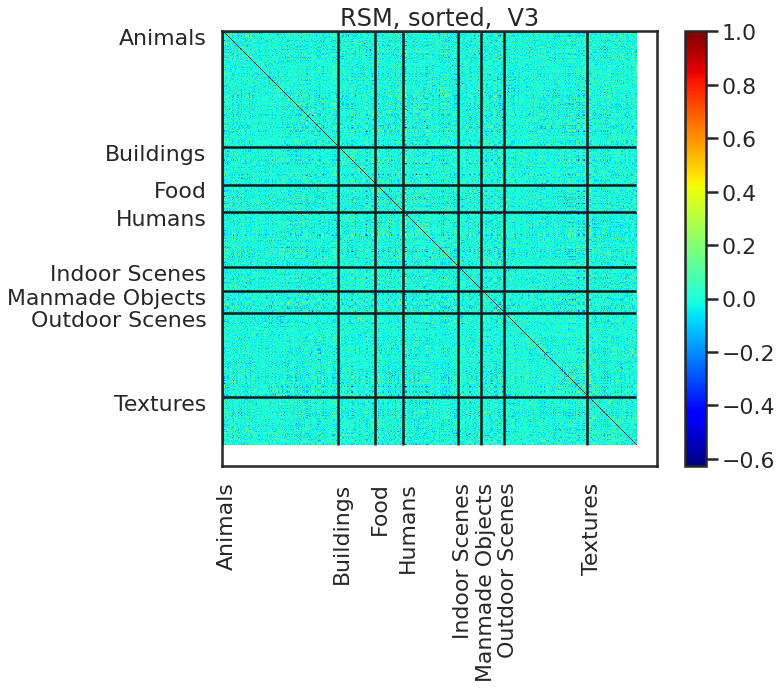

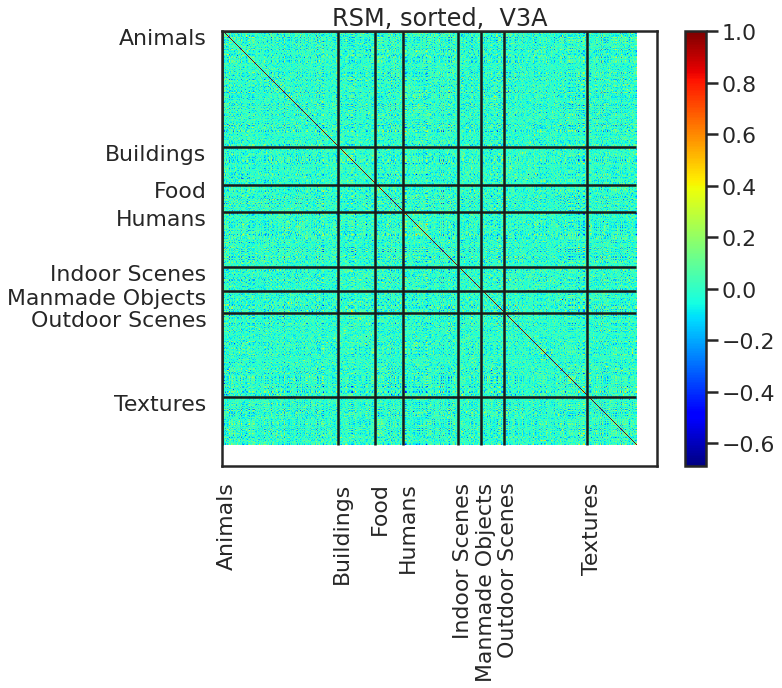

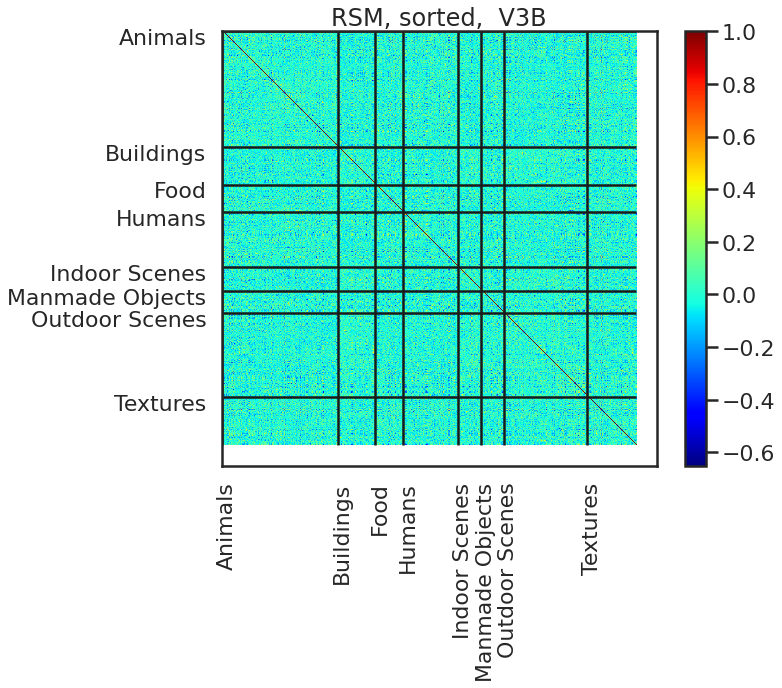

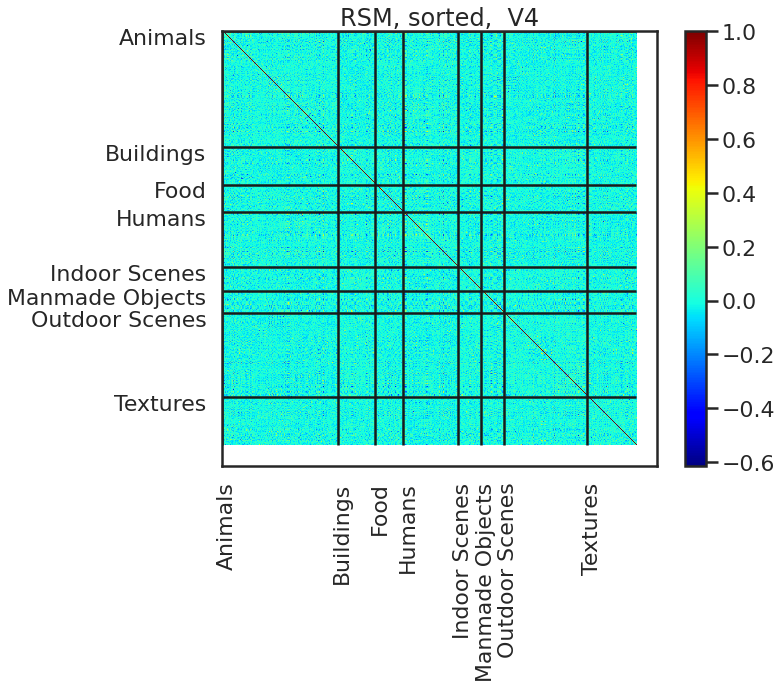

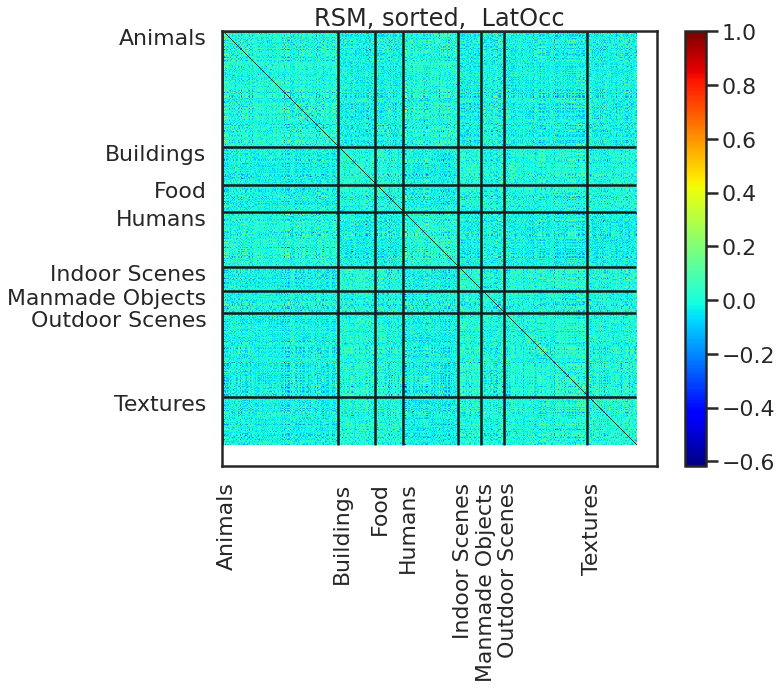

In [ ]:
## Plot couple of classes for all the region
## Animals
#label_id = y_train_ours["y_train"]== 1
#from scipy.stats import *
from sklearn.metrics import *
sort_ids = np.argsort(y_train_ours["y_train"], axis=0)

labels = ['Animals', 'Buildings', 'Food', 'Humans', 'Indoor Scenes', 'Manmade Objects', 'Outdoor Scenes', 'Textures']

binsize = np.histogram(y_train_ours["y_train"], 8)[0]
edges = np.concatenate([np.asarray([0]), np.cumsum(binsize)])[:-1]

################################################# 
# from scipy.stats import spearmanr
# rank_srm, _ = spearmanr(dat["responses"][:, roi_id])
#####################################################

for i in range(len(r)):
  id = i+1
  roi_id = dat["roi"]== id
  #rsm = pairwise_distances(dat["responses"][sort_ids, roi_id], metric='manhattan')
  rsm= np.corrcoef(dat["responses"][sort_ids, roi_id])
  print(dat["responses"][:, roi_id].shape, rsm.shape)
  f, ax = plt.subplots(1,1, figsize=(10, 8))
  plt.imshow(
      rsm, cmap='jet',# vmin=-0.3, vmax=0.3, 
      interpolation = 'none'
  )
  plt.colorbar()
  ax.set_xticks(list(np.array(edges)+20))
  ax.set_xticklabels(labels, rotation = 90)
  ax.set_yticks(list(np.array(edges)+20))
  ax.set_yticklabels(labels)
  ax.vlines(edges,0,1750)
  ax.hlines(edges,0,1750)
  #ax.set_xticklabels('Animals')
  #ax.set_yticklabels('Animals')
  ax.set_title('RSM, sorted,  %s' % r[id-1])

1294
928


Text(0.5, 1.0, 'RDM, LatOcc')

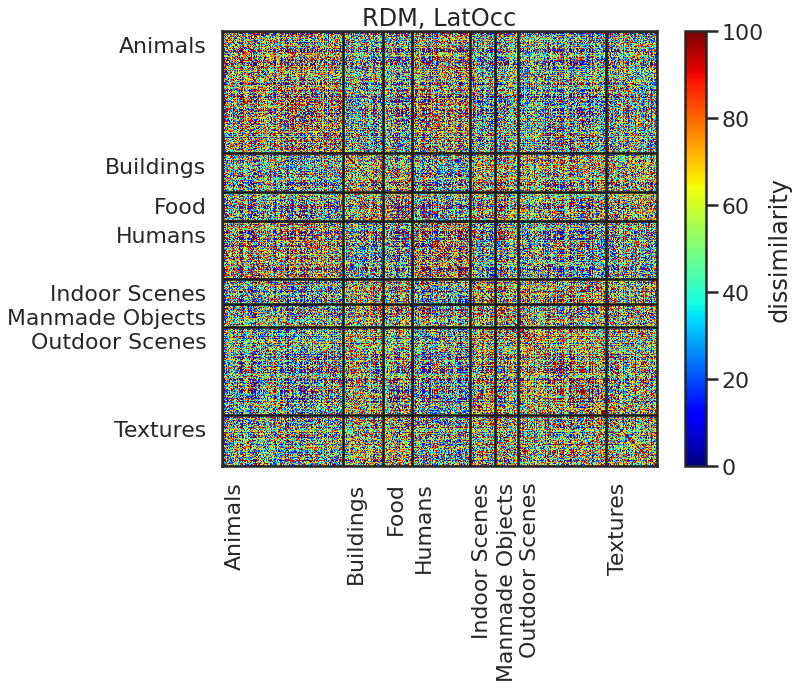

In [ ]:
def digitize_rdm(rdm_raw, n_bins = 10): 
    """Digitize an input matrix to n bins (10 bins by default)
    rdm_raw: a square matrix 
    """
    # compute the bins 
    
    rdm_bins = [np.percentile(np.ravel(rdm_raw), 100/n_bins * i) for i in range(n_bins)]
    # Compute the vectorized digitized value 
    rdm_vec_digitized = np.digitize(np.ravel(rdm_raw), bins = rdm_bins) * (100 // n_bins) 
    
    # Reshape to matrix
    rdm_digitized = np.reshape(rdm_vec_digitized, np.shape(rdm_raw)) 
    
    # Force symmetry in the plot
    rdm_digitized = (rdm_digitized + rdm_digitized.T) / 2
    
    return rdm_digitized

id = 1
roi_id_1 = dat["roi"]== id 
print(np.sum(roi_id_1 == True))
roi_id_2 = dat["roi"]== 2
roi_id_3 = dat["roi"]== 3
roi_id_4 = dat["roi"]== 4
roi_id_5 = dat["roi"]== 5
roi_id_6 = dat["roi"]== 6
roi_id_7 = dat["roi"]== 7
roi_id = roi_id_7
print(np.sum(roi_id == True))
#rsm = pairwise_distances(dat["responses"][sort_ids, roi_id], metric='cosine')
rsm= np.corrcoef(dat["responses"][sort_ids, roi_id])
rdm = digitize_rdm(rsm,n_bins=10)
f, ax = plt.subplots(1,1, figsize=(10, 8))
plt.imshow(
    rdm, cmap='jet', vmin=0, vmax=100, 
    interpolation = 'none'
)
cbar = plt.colorbar()
cbar.set_label('dissimilarity')
ax.set_xticks(list(np.array(edges)+50))
ax.set_xticklabels(labels, rotation = 90)
ax.set_yticks(list(np.array(edges)+50))
ax.set_yticklabels(labels)
ax.vlines(edges,0,1749)
ax.hlines(edges,0,1749)
ax.set_title('RDM, LatOcc')

In [ ]:
np.save('Corr_fMRI_cosine',rsm)
np.save('Dig_Corr_fMRI_cosine',rdm)

(1750, 8428)


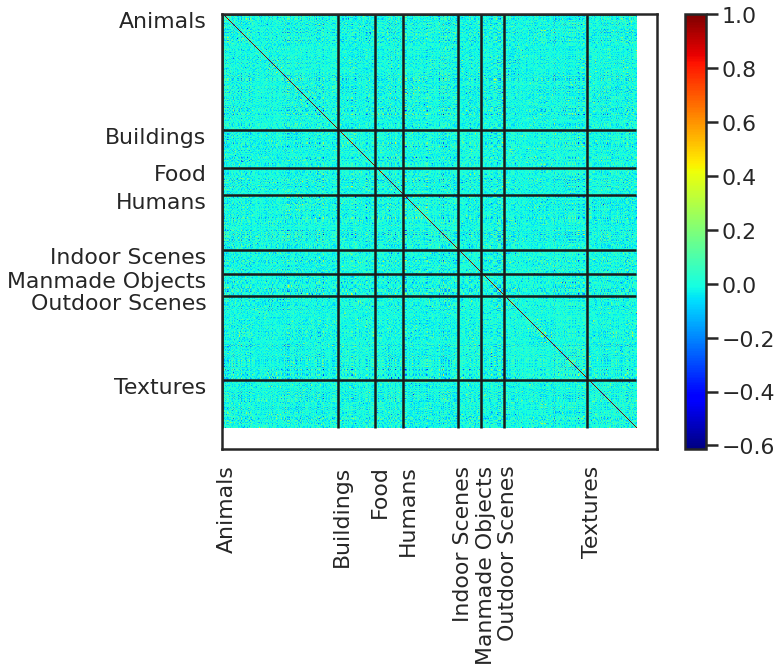

In [ ]:
sort_ids = np.argsort(y_train_ours["y_train"], axis=0)

labels = ['Animals', 'Buildings', 'Food', 'Humans', 'Indoor Scenes', 'Manmade Objects', 'Outdoor Scenes', 'Textures']

binsize = np.histogram(y_train_ours["y_train"], 8)[0]
edges = np.concatenate([np.asarray([0]), np.cumsum(binsize)])[:-1]

#rsm = pairwise_distances(dat["responses"][sort_ids, roi_id], metric='manhattan')
dat_reshape = np.reshape(dat["responses"][sort_ids,:],(1750,8428))
print(dat_reshape.shape)
rsm= np.corrcoef(dat_reshape)

f, ax = plt.subplots(1,1, figsize=(10, 8))
plt.imshow(
    rsm, cmap='jet',# vmin=-0.3, vmax=0.3, 
    interpolation = 'none'
)
plt.colorbar()
ax.set_xticks(list(np.array(edges)+20))
ax.set_xticklabels(labels, rotation = 90)
ax.set_yticks(list(np.array(edges)+20))
ax.set_yticklabels(labels)
ax.vlines(edges,0,1750)
ax.hlines(edges,0,1750)

In [ ]:
sum_zero = np.sum(np.abs(dat["responses"]) <= 0.3, axis=1)
print(sum_zero.shape)
print(sum_zero)

(1750,)
[2387 1995 2320 ... 1996 2097 1980]


In [ ]:
############ Thresholding
thr = 0.3
data_thr = dat["responses"]
data_thr[np.abs(data_thr) <= thr] = 0

Text(0.5, 1.0, 'RSM, sorted,  LatOcc')

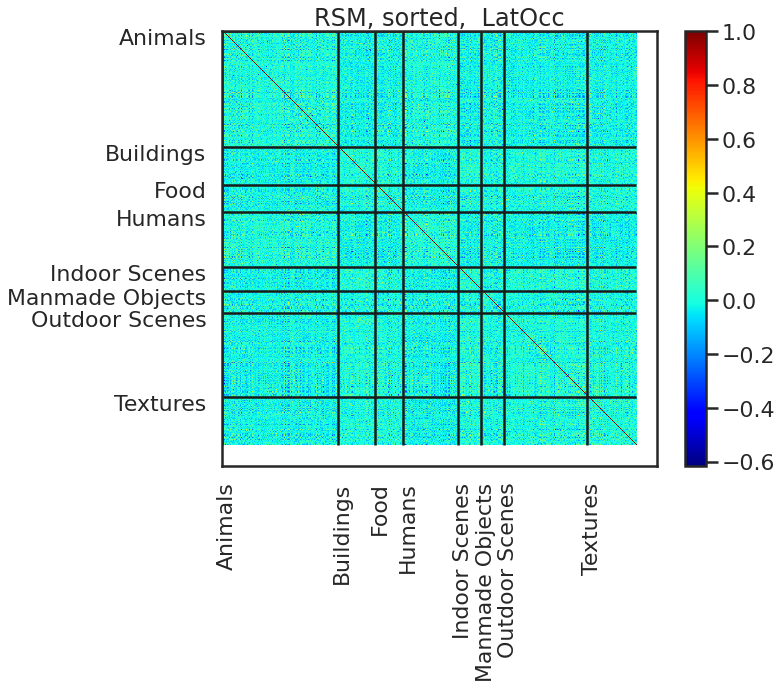

In [ ]:
id = 7
roi_id = dat["roi"]== id
rsm_thr= np.corrcoef(data_thr[sort_ids,roi_id])

f, ax = plt.subplots(1,1, figsize=(10, 8))
plt.imshow(
    rsm_thr, cmap='jet',# vmin=-0.3, vmax=0.3, 
    interpolation = 'none'
)
plt.colorbar()
ax.set_xticks(list(np.array(edges)+20))
ax.set_xticklabels(labels, rotation = 90)
ax.set_yticks(list(np.array(edges)+20))
ax.set_yticklabels(labels)
ax.vlines(edges,0,1750)
ax.hlines(edges,0,1750)
ax.set_title('RSM, sorted,  %s' % r[id-1])

In [ ]:
##################### DIMENSIONALITY REDUCTION #############################

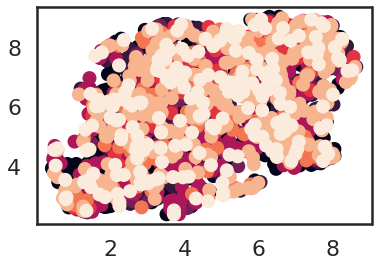

In [ ]:
import umap
reducer = umap.UMAP(n_components=2)
train_target = np.reshape(y_train_ours['y_train'][sort_ids],(1750,1))
#reducer.fit(coef_train, y=np.squeeze(train_target)) #Uncomment for *supervised* dim reduction (Radically different!)
id = 7
roi_id = dat["roi"]== id
coef_train= np.corrcoef(dat["responses"][sort_ids, roi_id])
reducer.fit(coef_train)
embedding = reducer.transform(coef_train)
plt.scatter(embedding[:,0], embedding[:,1],c=train_target)

In [ ]:
from io import BytesIO
from PIL import Image
import base64
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
from bokeh.palettes import Spectral8
import pandas as pd

output_notebook()

In [ ]:
def embeddable_image(data):
    img_data = (np.floor(128+data * 128)).astype(np.uint8)
    image = Image.fromarray(img_data, mode='L').resize((128, 128), Image.BICUBIC)
    buffer = BytesIO()
    image.save(buffer, format='png')
    for_encoding = buffer.getvalue()
    return 'data:image/png;base64,' + base64.b64encode(for_encoding).decode()

In [ ]:
train_target_labels = [labels[np.squeeze(y-1)] for y in train_target]

images_df = pd.DataFrame(embedding, columns=('x', 'y'))
images_df['label'] = train_target_labels
images_df['image'] = list(map(embeddable_image, dat['stimuli'][np.squeeze(sort_ids),:,:]))

datasource = ColumnDataSource(images_df)
color_mapping = CategoricalColorMapper(factors=labels,
                                       palette=Spectral8)

plot_figure = figure(
    title='UMAP projection of LatOcc ROI RDM',
    plot_width=600,
    plot_height=600,
    tools=('pan, wheel_zoom, reset')
)

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@image' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 16px; color: #224499'>Label:</span>
        <span style='font-size: 18px'>@label</span>
    </div>
</div>
"""))

plot_figure.circle(
    'x',
    'y',
    source=datasource,
    color=dict(field='label', transform=color_mapping),
    line_alpha=0.6,
    fill_alpha=0.6,
    size=4
)
show(plot_figure)

In [ ]:
#################### PCA #####################

In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
data_pca = pca.fit_transform(dat["responses"][sort_ids,roi_id])

In [ ]:
train_target_labels = [labels[np.squeeze(y-1)] for y in train_target]

images_df = pd.DataFrame(data_pca, columns=('x', 'y'))
images_df['label'] = train_target_labels
images_df['image'] = list(map(embeddable_image, dat['stimuli'][np.squeeze(sort_ids),:,:]))

datasource = ColumnDataSource(images_df)
color_mapping = CategoricalColorMapper(factors=labels,
                                       palette=Spectral8)

plot_figure = figure(
    title='UMAP projection of LatOcc ROI RDM',
    plot_width=600,
    plot_height=600,
    tools=('pan, wheel_zoom, reset')
)

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@image' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 16px; color: #224499'>Label:</span>
        <span style='font-size: 18px'>@label</span>
    </div>
</div>
"""))

plot_figure.circle(
    'x',
    'y',
    source=datasource,
    color=dict(field='label', transform=color_mapping),
    line_alpha=0.6,
    fill_alpha=0.6,
    size=4
)
show(plot_figure)